<a href="https://colab.research.google.com/github/jiyoung-99/ML_practice/blob/master/S2_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

이 데이터는 비행기 고객의 만족도을 포함한다. 어떤 요소들이 고객의 높은 만족도를 상관하고 있는지 보고 고객들의 만족도를 예측해보자.

Gender: Gender of the passengers (Female, Male)

Customer Type: The customer type (Loyal customer, disloyal customer)

Age: The actual age of the passengers

Type of Travel: Purpose of the flight of the passengers (Personal Travel, Business Travel)

Class: Travel class in the plane of the passengers (Business, Eco, Eco Plus)

Flight distance: The flight distance of this journey

Inflight wifi service: Satisfaction level of the inflight wifi service (0:Not Applicable;1-5)

Departure/Arrival time convenient: Satisfaction level of Departure/Arrival time convenient

Ease of Online booking: Satisfaction level of online booking

Gate location: Satisfaction level of Gate location

Food and drink: Satisfaction level of Food and drink

Online boarding: Satisfaction level of online boarding

Seat comfort: Satisfaction level of Seat comfort

Inflight entertainment: Satisfaction level of inflight entertainment

On-board service: Satisfaction level of On-board service

Leg room service: Satisfaction level of Leg room service

Baggage handling: Satisfaction level of baggage handling

Check-in service: Satisfaction level of Check-in service

Inflight service: Satisfaction level of inflight service

Cleanliness: Satisfaction level of Cleanliness

Departure Delay in Minutes: Minutes delayed when departure

Arrival Delay in Minutes: Minutes delayed when Arrival

Satisfaction: Airline satisfaction level(Satisfaction, neutral or dissatisfaction)

In [1]:
!pip install category_encoders
!pip uninstall pandas-profiling
!pip install pandas-profiling==2.*

     |████████████████████████████████| 81kB 6.7MB/s 
Uninstalling pandas-profiling-1.4.1:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/pandas_profiling-1.4.1.dist-info/*
    /usr/local/lib/python3.7/dist-packages/pandas_profiling/*
Proceed (y/n)? y
  Successfully uninstalled pandas-profiling-1.4.1
     |████████████████████████████████| 245kB 13.4MB/s 
     |████████████████████████████████| 61kB 7.7MB/s 
     |████████████████████████████████| 81kB 7.9MB/s 
     |████████████████████████████████| 604kB 20.2MB/s 
     |████████████████████████████████| 3.1MB 28.9MB/s 
     |████████████████████████████████| 81kB 9.8MB/s 
     |████████████████████████████████| 296kB 36.7MB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp37-none-any.whl size=27085 sha256=77f76604de4128564ec0c10b226621ec72690ce9134d7638cc6cc804b248e93a
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
  Created wheel for phik: filename=phik

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_auc_score, roc_curve, accuracy_score, confusion_matrix, log_loss, plot_roc_curve, auc, precision_recall_curve
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder

In [3]:
test_df = pd.read_csv('https://raw.githubusercontent.com/jiyoung-99/csvs/3446c242f05708acc4c750f2944b002ebb9fd181/Airline_Passenger_Satisfaction/test.csv')
train_df = pd.read_csv('https://raw.githubusercontent.com/jiyoung-99/csvs/3446c242f05708acc4c750f2944b002ebb9fd181/Airline_Passenger_Satisfaction/train.csv')

In [4]:
from pandas_profiling import ProfileReport
ProfileReport(train_df)

Summarize dataset:   0%|          | 0/38 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [5]:
train_df['satisfaction'].value_counts()

neutral or dissatisfied    58879
satisfied                  45025
Name: satisfaction, dtype: int64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


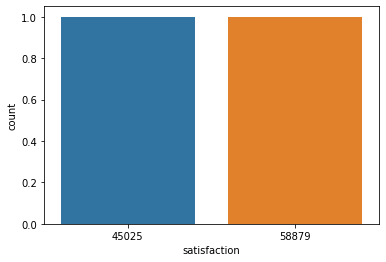

In [6]:
sns.countplot(train_df['satisfaction'].value_counts())

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


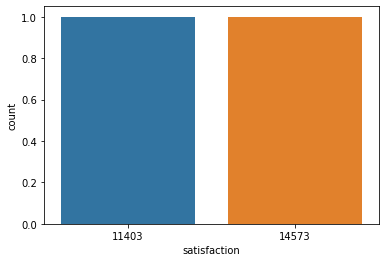

In [7]:
sns.countplot(test_df['satisfaction'].value_counts())

In [8]:
# satisfied 이면 1, 아니면 0
def trans_target(df):
    df['satisfaction'] = [1 if col == 'satisfied' else 0 for col in df['satisfaction']]

    return df

In [9]:
train_df = trans_target(train_df)
test_df = trans_target(test_df)

In [10]:
train_df.drop('Unnamed: 0', axis=1, inplace=True)
test_df.drop('Unnamed: 0', axis=1, inplace=True)

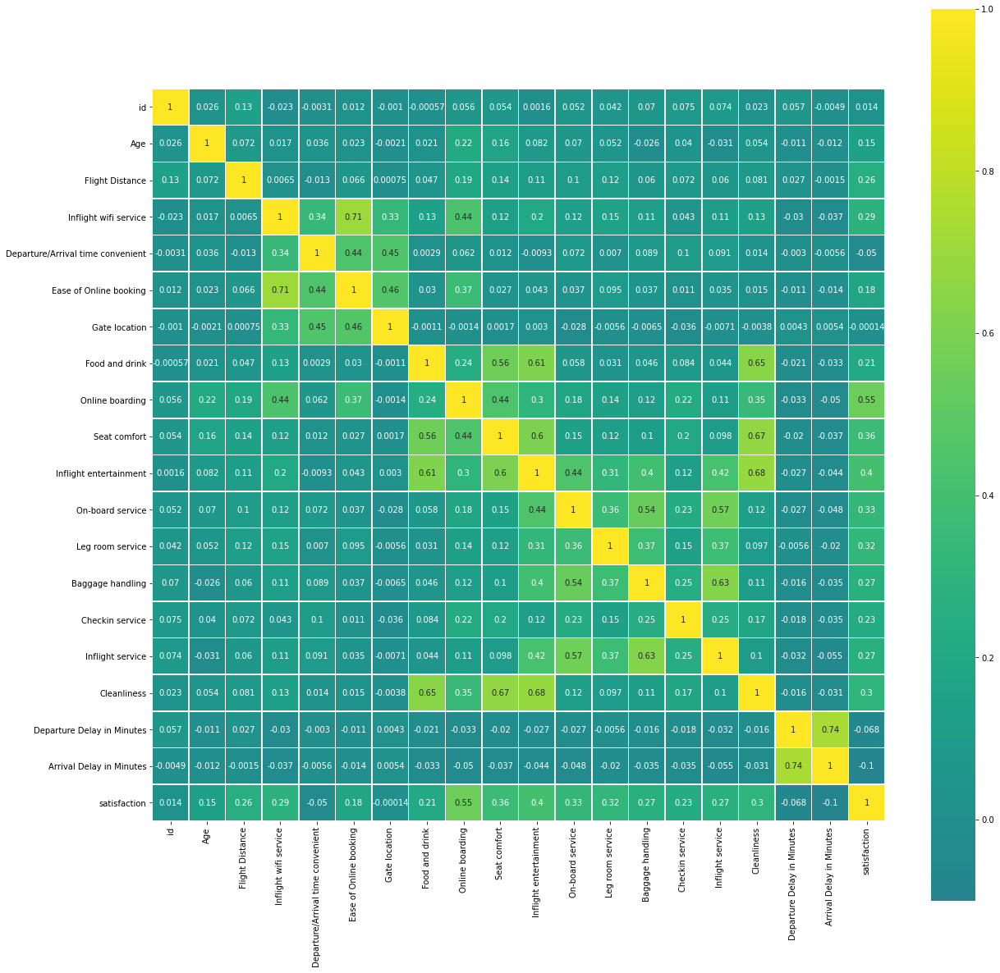

In [11]:
corr = train_df.corr(method='spearman')
figure, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(corr, annot = True, cmap="viridis", center=0, square=True, linewidths=.5)

In [12]:
def engineer(df):
    service = [col for col in df.columns if 'service' in col]
    df['service'] = df[service].sum(axis=1)

    return df

In [13]:
train_df = engineer(train_df)
test_df = engineer(test_df)

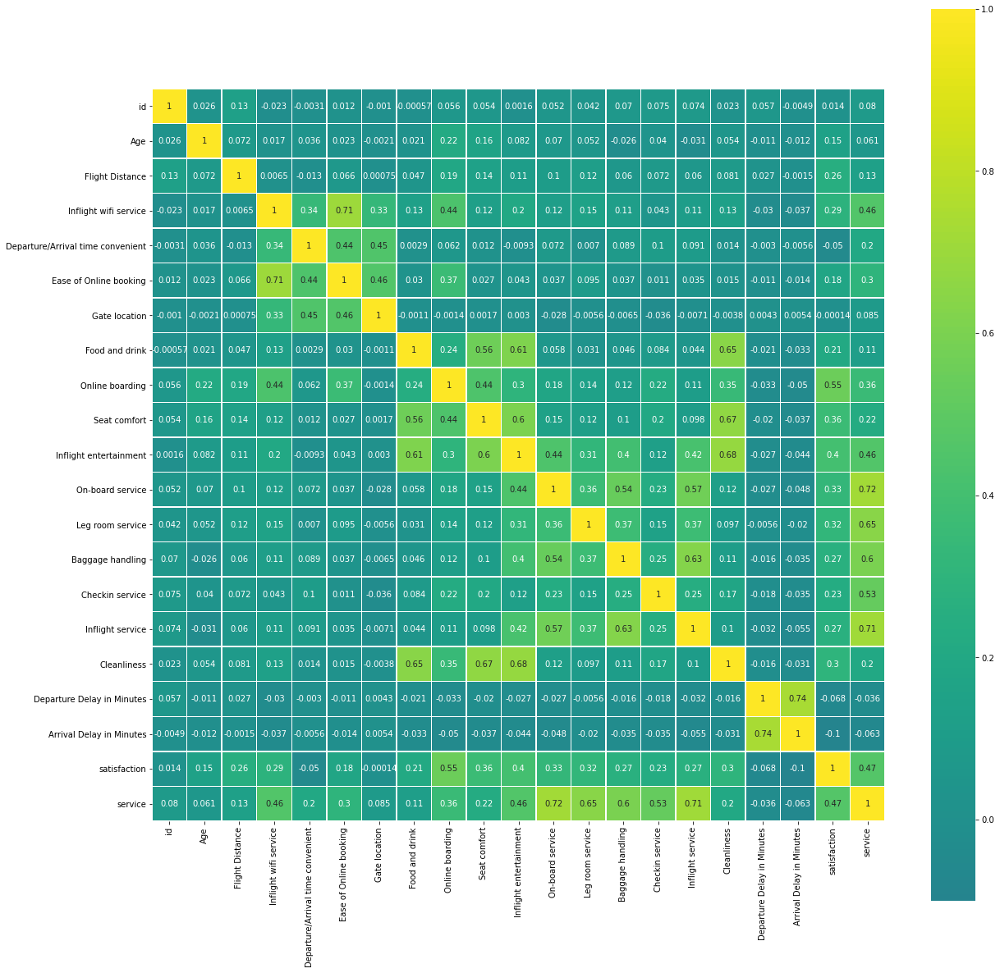

In [14]:
corr = train_df.corr(method='spearman')
figure, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(corr, annot = True, cmap="viridis", center=0, square=True, linewidths=.5)

성별, 클래스별 만족, 불만족을 나타낸다. 1에 가까울 수록 만족이 높다는 뜻이다.

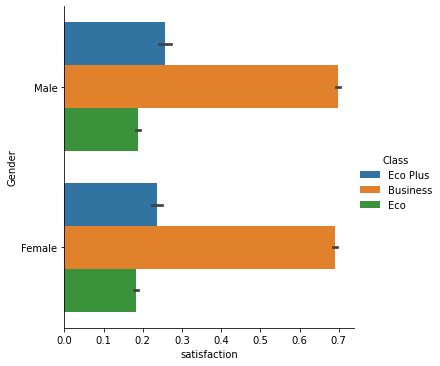

In [15]:
sns.catplot(x="satisfaction", y="Gender", hue="Class", kind="bar", data=train_df)

나이별 불만족, 만족의 비율을 나타낸다.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


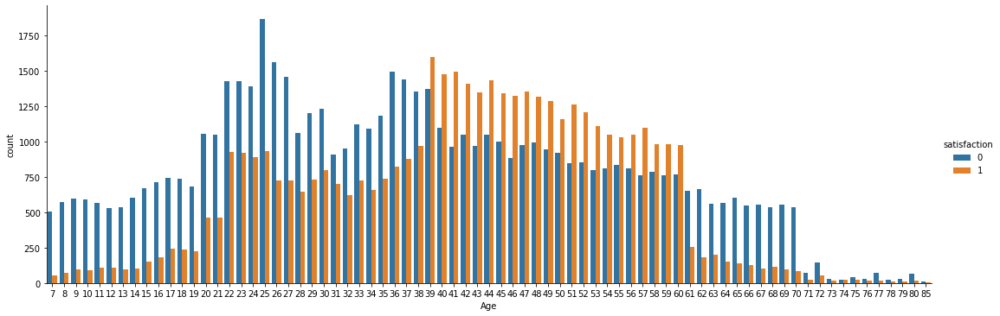

In [16]:
sns.catplot("Age", data=train_df, aspect=3.0, kind='count', hue='satisfaction')

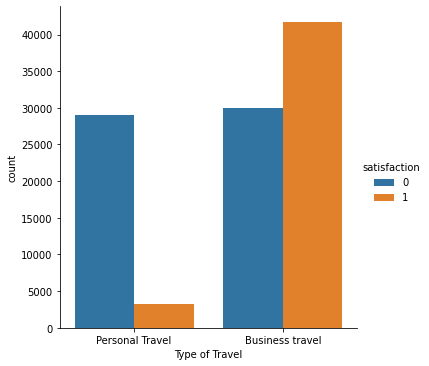

In [17]:
sns.catplot(x='Type of Travel', hue='satisfaction', data=train_df, kind='count')

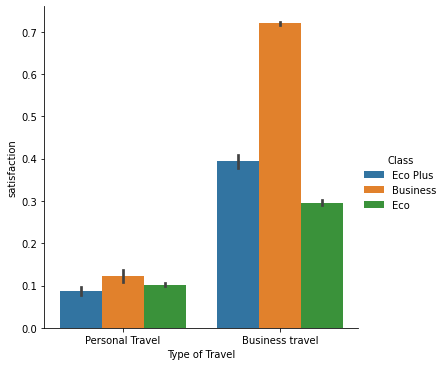

In [18]:
sns.catplot(x='Type of Travel', y="satisfaction", hue='Class', data=train_df, kind='bar')

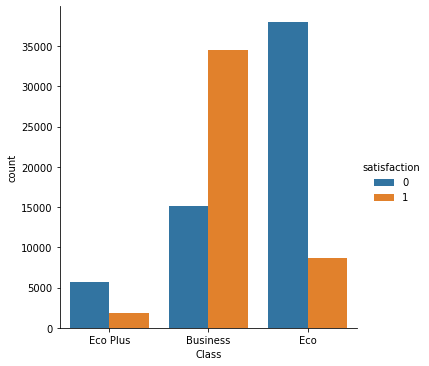

In [19]:
sns.catplot(x='Class', hue='satisfaction', data=train_df, kind='count')

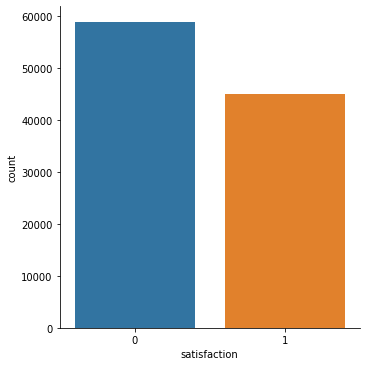

In [20]:
sns.catplot(x='satisfaction', data=train_df, kind="count")

In [21]:
train_df_cat = train_df.select_dtypes(include='object')\
                            .columns \
                            .to_list()

In [22]:
train_df_num = train_df.select_dtypes(include='number')\
                            .columns \
                            .to_list()

In [23]:
train_df_cat

['Gender', 'Customer Type', 'Type of Travel', 'Class']

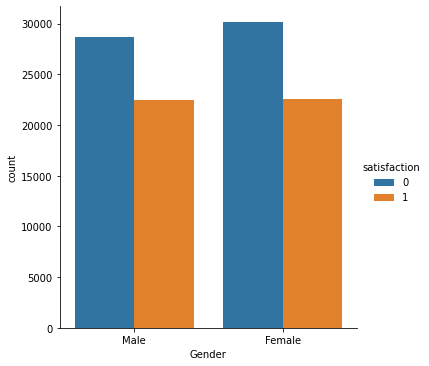

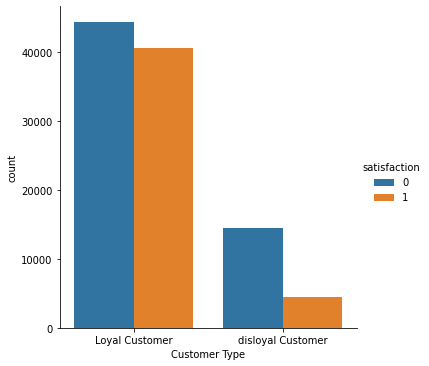

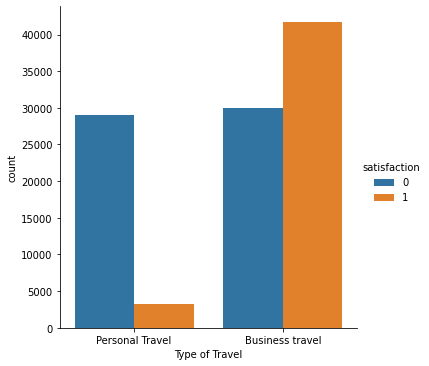

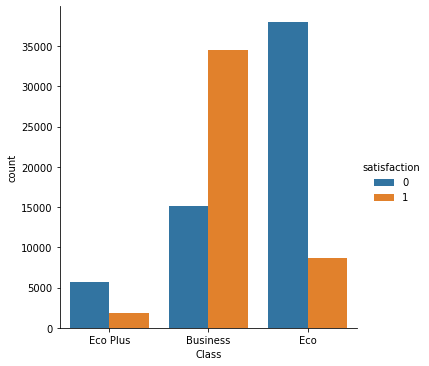

In [24]:
for i in train_df_cat:
    sns.catplot(x=i, hue='satisfaction', data=train_df, kind='count')

In [25]:
target = ['satisfaction']
x_df = train_df.drop(target, axis=1)
y_df = train_df[target]
X_test = test_df.drop(target, axis=1)
y_test = test_df[target]

In [26]:
x_df.select_dtypes(include='object')

,Gender,Customer Type,Type of Travel,Class
0,Male,Loyal Customer,Personal Travel,Eco Plus
1,Male,disloyal Customer,Business travel,Business
2,Female,Loyal Customer,Business travel,Business
3,Female,Loyal Customer,Business travel,Business
4,Male,Loyal Customer,Business travel,Business
...,...,...,...,...
103899,Female,disloyal Customer,Business travel,Eco
103900,Male,Loyal Customer,Business travel,Business
103901,Male,disloyal Customer,Business travel,Business
103902,Female,disloyal Customer,Business travel,Eco


In [27]:
x_df['Customer Type'].value_counts()

Loyal Customer       84923
disloyal Customer    18981
Name: Customer Type, dtype: int64

In [28]:
x_df['Type of Travel'].value_counts()

Business travel    71655
Personal Travel    32249
Name: Type of Travel, dtype: int64

In [29]:
x_df['Class'].value_counts()

Business    49665
Eco         46745
Eco Plus     7494
Name: Class, dtype: int64

In [30]:
gender_map = {
    'Male' :    0,
    'Female'    :  1
    } 
Customer_Type_map = {
    'Loyal Customer' : 1,
    'disloyal Customer' : 0
}
Type_of_Travel_map = {
    'Business travel': 1,
    'Personal Travel':0
}
Class_map = {
    'Eco':0,
    'Eco Plus':1,
    'Business':2
}

In [31]:
def trans_map(df):
    df['Gender'] = df['Gender'].map(gender_map)
    df['Customer Type'] = df['Customer Type'].map(Customer_Type_map)
    df['Type of Travel'] = df['Type of Travel'].map(Type_of_Travel_map)
    df['Class'] = df['Class'].map(Class_map)
    return df

In [32]:
x_df = trans_map(x_df)
X_test = trans_map(X_test)

object 타입 레이블 인코딩한다.

In [33]:
X_train, X_val, y_train, y_val = train_test_split(x_df, y_df, test_size=0.3)

In [34]:
X_train.shape, X_val.shape, X_test.shape, y_train.shape, y_val.shape, y_test.shape

((72732, 24), (31172, 24), (25976, 24), (72732, 1), (31172, 1), (25976, 1))

In [35]:
num_pipeline = Pipeline(steps=[
                         ('imputer', SimpleImputer(strategy='mean'))
])

In [36]:
from sklearn.compose import ColumnTransformer
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

In [37]:
dtc = DecisionTreeClassifier()
parameters = {
            'classifier__max_depth':[None, 1, 2],
            'classifier__min_samples_split':[1, 2]
}
tree_pipeline = Pipeline(steps=[('num_pipeline', num_pipeline),
                                ('classifier', dtc)])


In [38]:
grid_tree = GridSearchCV(estimator=tree_pipeline, param_grid=parameters, cv=2, refit=True)

In [39]:
grid_tree.fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
ValueError: min_samples_split must be an integer greater than 1 or a float in (0.0, 1.0]; got the integer 1

  FitFailedWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
ValueError: min_samples_split must be an integer greater than 1 or a float in (0.0, 1.0]; got the integer 1

  FitFailedWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
ValueError: min_samples_split must be an integer greater than 1 or a float in (0.0, 1.0]; got the integ

GridSearchCV(cv=2, error_score=nan,
             estimator=Pipeline(memory=None,
                                steps=[('num_pipeline',
                                        Pipeline(memory=None,
                                                 steps=[('imputer',
                                                         SimpleImputer(add_indicator=False,
                                                                       copy=True,
                                                                       fill_value=None,
                                                                       missing_values=nan,
                                                                       strategy='mean',
                                                                       verbose=0))],
                                                 verbose=False)),
                                       ('classifier',
                                        DecisionTreeClassifier(ccp_alpha=0.0,
         

In [40]:
grid_tree.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__memory', 'estimator__steps', 'estimator__verbose', 'estimator__num_pipeline', 'estimator__classifier', 'estimator__num_pipeline__memory', 'estimator__num_pipeline__steps', 'estimator__num_pipeline__verbose', 'estimator__num_pipeline__imputer', 'estimator__num_pipeline__imputer__add_indicator', 'estimator__num_pipeline__imputer__copy', 'estimator__num_pipeline__imputer__fill_value', 'estimator__num_pipeline__imputer__missing_values', 'estimator__num_pipeline__imputer__strategy', 'estimator__num_pipeline__imputer__verbose', 'estimator__classifier__ccp_alpha', 'estimator__classifier__class_weight', 'estimator__classifier__criterion', 'estimator__classifier__max_depth', 'estimator__classifier__max_features', 'estimator__classifier__max_leaf_nodes', 'estimator__classifier__min_impurity_decrease', 'estimator__classifier__min_impurity_split', 'estimator__classifier__min_samples_leaf', 'estimator__classifier__min_samples_split', 'estimator__classifie

In [41]:
print(grid_tree.best_estimator_)

Pipeline(memory=None,
         steps=[('num_pipeline',
                 Pipeline(memory=None,
                          steps=[('imputer',
                                  SimpleImputer(add_indicator=False, copy=True,
                                                fill_value=None,
                                                missing_values=nan,
                                                strategy='mean', verbose=0))],
                          verbose=False)),
                ('classifier',
                 DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None,
                                        criterion='gini', max_depth=None,
                                        max_features=None, max_leaf_nodes=None,
                                        min_impurity_decrease=0.0,
                                        min_impurity_split=None,
                                        min_samples_leaf=1, min_samples_split=2,
                                        min_weight_fra

In [42]:
y_val_pred = grid_tree.predict(X_val)

In [43]:
y_val_pred_proba = grid_tree.predict_proba(X_val)[:, 1]

In [44]:
y_val_pred_proba

array([0., 1., 0., ..., 0., 0., 0.])

In [45]:
grid_tree.score(X_val, y_val)

0.9422237905812909

In [46]:
from sklearn.metrics import classification_report
print(classification_report(y_val, y_val_pred))
print('Confusion matrix : \n{}'.format(confusion_matrix(y_val,y_val_pred)))
print('\n')
print('Accuracy score : {}'.format(accuracy_score(y_val,y_val_pred)))

              precision    recall  f1-score   support

           0       0.95      0.95      0.95     17630
           1       0.93      0.94      0.93     13542

    accuracy                           0.94     31172
   macro avg       0.94      0.94      0.94     31172
weighted avg       0.94      0.94      0.94     31172

Confusion matrix : 
[[16695   935]
 [  866 12676]]


Accuracy score : 0.9422237905812909


In [47]:
roc_score = roc_auc_score(y_val, y_val_pred_proba)

In [48]:
print('ROC_AUC', roc_score)

ROC_AUC 0.9415081023949105


랜덤포레스트 방식

In [49]:
from sklearn.ensemble import RandomForestClassifier


In [50]:
num_pipeline = Pipeline(steps=[
                         ('imputer', SimpleImputer(strategy='mean'))
])
rfc = RandomForestClassifier()
parameters = {
            'classifier__max_depth':[None, 1, 2],
            'classifier__min_samples_split':[1, 2]
}
tree_pipeline = Pipeline(steps=[('num_pipeline', num_pipeline),
                                ('classifier', rfc)])

In [51]:
grid_tree2 = GridSearchCV(estimator=tree_pipeline, param_grid=parameters, cv=2, refit=True)

In [52]:
grid_tree2.fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/pipeline.py:354: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
ValueError: min_samples_split must be an integer greater than 1 or a float in (0.0, 1.0]; got the integer 1

  FitFailedWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/pipeline.py:354: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:536: FitFailedWarning: Estimator fit failed.

GridSearchCV(cv=2, error_score=nan,
             estimator=Pipeline(memory=None,
                                steps=[('num_pipeline',
                                        Pipeline(memory=None,
                                                 steps=[('imputer',
                                                         SimpleImputer(add_indicator=False,
                                                                       copy=True,
                                                                       fill_value=None,
                                                                       missing_values=nan,
                                                                       strategy='mean',
                                                                       verbose=0))],
                                                 verbose=False)),
                                       ('classifier',
                                        RandomForestClassifier(bootstrap=True,
        

In [53]:
print('최적 파라미터', grid_tree2.best_estimator_)

최적 파라미터 Pipeline(memory=None,
         steps=[('num_pipeline',
                 Pipeline(memory=None,
                          steps=[('imputer',
                                  SimpleImputer(add_indicator=False, copy=True,
                                                fill_value=None,
                                                missing_values=nan,
                                                strategy='mean', verbose=0))],
                          verbose=False)),
                ('classifier',
                 RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                                        class_weight=None, criterion='gini',
                                        max_depth=None, max_features='auto',
                                        max_leaf_nodes=None, max_samples=None,
                                        min_impurity_decrease=0.0,
                                        min_impurity_split=None,
                                        min_samples

In [54]:
print('최적 스코어', grid_tree2.best_score_)

최적 스코어 0.9580652257603256


In [55]:
y_val_pred2 = grid_tree2.predict(X_val)

In [56]:
print(classification_report(y_val, y_val_pred2))
print('Confusion matrix : \n{}'.format(confusion_matrix(y_val,y_val_pred2)))
print('\n')
print('Accuracy score : {}'.format(accuracy_score(y_val,y_val_pred2)))

              precision    recall  f1-score   support

           0       0.96      0.98      0.97     17630
           1       0.97      0.94      0.96     13542

    accuracy                           0.96     31172
   macro avg       0.96      0.96      0.96     31172
weighted avg       0.96      0.96      0.96     31172

Confusion matrix : 
[[17266   364]
 [  789 12753]]


Accuracy score : 0.9630116771461568


In [57]:
y_test_pred = grid_tree2.predict(X_test)

In [58]:
print(classification_report(y_test, y_test_pred))
print('Confusion matrix : \n{}'.format(confusion_matrix(y_test,y_test_pred)))
print('\n')
print('Accuracy score : {}'.format(accuracy_score(y_test,y_test_pred)))

              precision    recall  f1-score   support

           0       0.96      0.98      0.97     14573
           1       0.97      0.94      0.96     11403

    accuracy                           0.96     25976
   macro avg       0.96      0.96      0.96     25976
weighted avg       0.96      0.96      0.96     25976

Confusion matrix : 
[[14261   312]
 [  641 10762]]


Accuracy score : 0.9633122882660918


In [59]:
from sklearn.metrics import classification_report
print(classification_report(y_val, y_val_pred2))

              precision    recall  f1-score   support

           0       0.96      0.98      0.97     17630
           1       0.97      0.94      0.96     13542

    accuracy                           0.96     31172
   macro avg       0.96      0.96      0.96     31172
weighted avg       0.96      0.96      0.96     31172



GBM 이용

In [60]:
from sklearn.ensemble import GradientBoostingClassifier

In [61]:
num_pipeline = Pipeline(steps=[
                               ('imputer', SimpleImputer(strategy='mean'))
])
gbc = GradientBoostingClassifier()
parameters = {
            'gbc__n_estimators':[100, 200],
            'gbc__learning_rate':[0.05, 0.1],
            'gbc__max_depth':[None, 1, 2],
            'gbc__min_samples_split':[1, 2]
}
# learning_rate : GBM이 학습을 진행할 때마다 적용하는 학습률, 0~1사이의 값 지정 가능 작은 값은 업데이트 되는 값이 작아져 예측 성능이 높아지지만 수행시간이 오래 걸린다.
# n_estimator : 갯수가 많을 수록 수행 시간이 오래 걸리지만 순차적으로 오류를 보정하므로 예측 성능이 일정 수준까지 좋아진다.
gb_pipeline = Pipeline(steps=[
                              ('num_pipeline', num_pipeline),
                              ('gbc', gbc)
])

In [62]:
grid_tree3 = GridSearchCV(estimator=gb_pipeline, param_grid=parameters, cv=3, refit=True)

dict_keys(['cv', 'error_score', 'estimator__memory', 'estimator__steps', 'estimator__verbose', 'estimator__num_pipeline', 'estimator__gbc', 'estimator__num_pipeline__memory', 'estimator__num_pipeline__steps', 'estimator__num_pipeline__verbose', 'estimator__num_pipeline__imputer', 'estimator__num_pipeline__imputer__add_indicator', 'estimator__num_pipeline__imputer__copy', 'estimator__num_pipeline__imputer__fill_value', 'estimator__num_pipeline__imputer__missing_values', 'estimator__num_pipeline__imputer__strategy', 'estimator__num_pipeline__imputer__verbose', 'estimator__gbc__ccp_alpha', 'estimator__gbc__criterion', 'estimator__gbc__init', 'estimator__gbc__learning_rate', 'estimator__gbc__loss', 'estimator__gbc__max_depth', 'estimator__gbc__max_features', 'estimator__gbc__max_leaf_nodes', 'estimator__gbc__min_impurity_decrease', 'estimator__gbc__min_impurity_split', 'estimator__gbc__min_samples_leaf', 'estimator__gbc__min_samples_split', 'estimator__gbc__min_weight_fraction_leaf', 'estimator__gbc__n_estimators', 'estimator__gbc__n_iter_no_change', 'estimator__gbc__presort', 'estimator__gbc__random_state', 'estimator__gbc__subsample', 'estimator__gbc__tol', 'estimator__gbc__validation_fraction', 'estimator__gbc__verbose', 'estimator__gbc__warm_start', 'estimator', 'iid', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [63]:
grid_tree3.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__memory', 'estimator__steps', 'estimator__verbose', 'estimator__num_pipeline', 'estimator__gbc', 'estimator__num_pipeline__memory', 'estimator__num_pipeline__steps', 'estimator__num_pipeline__verbose', 'estimator__num_pipeline__imputer', 'estimator__num_pipeline__imputer__add_indicator', 'estimator__num_pipeline__imputer__copy', 'estimator__num_pipeline__imputer__fill_value', 'estimator__num_pipeline__imputer__missing_values', 'estimator__num_pipeline__imputer__strategy', 'estimator__num_pipeline__imputer__verbose', 'estimator__gbc__ccp_alpha', 'estimator__gbc__criterion', 'estimator__gbc__init', 'estimator__gbc__learning_rate', 'estimator__gbc__loss', 'estimator__gbc__max_depth', 'estimator__gbc__max_features', 'estimator__gbc__max_leaf_nodes', 'estimator__gbc__min_impurity_decrease', 'estimator__gbc__min_impurity_split', 'estimator__gbc__min_samples_leaf', 'estimator__gbc__min_samples_split', 'estimator__gbc__min_weight_fraction_leaf', 'esti

In [64]:
grid_tree3.fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:1454: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
ValueError: min_samples_split must be an integer greater than 1 or a float in (0.0, 1.0]; got the integer 1

  FitFailedWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py:1454: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this t

GridSearchCV(cv=3, error_score=nan,
             estimator=Pipeline(memory=None,
                                steps=[('num_pipeline',
                                        Pipeline(memory=None,
                                                 steps=[('imputer',
                                                         SimpleImputer(add_indicator=False,
                                                                       copy=True,
                                                                       fill_value=None,
                                                                       missing_values=nan,
                                                                       strategy='mean',
                                                                       verbose=0))],
                                                 verbose=False)),
                                       ('gbc',
                                        GradientBoostingClassifier(ccp_alpha=0.0,
            

In [65]:
y_val_pred3 = grid_tree3.predict(X_val)

In [66]:
grid_tree3.best_estimator_

Pipeline(memory=None,
         steps=[('num_pipeline',
                 Pipeline(memory=None,
                          steps=[('imputer',
                                  SimpleImputer(add_indicator=False, copy=True,
                                                fill_value=None,
                                                missing_values=nan,
                                                strategy='mean', verbose=0))],
                          verbose=False)),
                ('gbc',
                 GradientBoostingClassifier(ccp_alpha=0.0,
                                            criterion='friedman_mse', init=None,
                                            learning_rate=0.05, loss='deviance',
                                            max_depth=None, max_features=None,
                                            max_leaf_nodes=None,
                                            min_impurity_decrease=0.0,
                                            min_impurity_split=Non

In [67]:
grid_tree3.best_score_

0.945457295275807

In [68]:
accuracy_score(y_val, y_val_pred3)

0.9462658796355704

In [69]:
print(classification_report(y_val, y_val_pred3))
print('Confusion matrix : \n{}'.format(confusion_matrix(y_val,y_val_pred3)))
print('\n')
print('Accuracy score : {}'.format(accuracy_score(y_val,y_val_pred3)))

              precision    recall  f1-score   support

           0       0.95      0.95      0.95     17630
           1       0.94      0.94      0.94     13542

    accuracy                           0.95     31172
   macro avg       0.95      0.95      0.95     31172
weighted avg       0.95      0.95      0.95     31172

Confusion matrix : 
[[16806   824]
 [  851 12691]]


Accuracy score : 0.9462658796355704


XGBoost

In [70]:
from xgboost import XGBClassifier

In [71]:
xgb = XGBClassifier()
num_pipeline = Pipeline(steps=[
                               ('imputer', SimpleImputer(strategy='mean'))
])
param_xgb = {
    'n_estimators':[100, 200],
    'learning_rate':[0.05, 0.1],
    'early_stopping_rounds':[100],
    'max_depth':[1, 2, 3]
}
grid_xgb = GridSearchCV(xgb, param_grid=param_xgb, cv=3, scoring='accuracy')
grid_xgb.get_params().keys()


dict_keys(['cv', 'error_score', 'estimator__base_score', 'estimator__booster', 'estimator__colsample_bylevel', 'estimator__colsample_bynode', 'estimator__colsample_bytree', 'estimator__gamma', 'estimator__learning_rate', 'estimator__max_delta_step', 'estimator__max_depth', 'estimator__min_child_weight', 'estimator__missing', 'estimator__n_estimators', 'estimator__n_jobs', 'estimator__nthread', 'estimator__objective', 'estimator__random_state', 'estimator__reg_alpha', 'estimator__reg_lambda', 'estimator__scale_pos_weight', 'estimator__seed', 'estimator__silent', 'estimator__subsample', 'estimator__verbosity', 'estimator', 'iid', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [72]:
grid_xgb.fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:235: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:268: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


GridSearchCV(cv=3, error_score=nan,
             estimator=XGBClassifier(base_score=0.5, booster='gbtree',
                                     colsample_bylevel=1, colsample_bynode=1,
                                     colsample_bytree=1, gamma=0,
                                     learning_rate=0.1, max_delta_step=0,
                                     max_depth=3, min_child_weight=1,
                                     missing=None, n_estimators=100, n_jobs=1,
                                     nthread=None, objective='binary:logistic',
                                     random_state=0, reg_alpha=0, reg_lambda=1,
                                     scale_pos_weight=1, seed=None, silent=None,
                                     subsample=1, verbosity=1),
             iid='deprecated', n_jobs=None,
             param_grid={'early_stopping_rounds': [100],
                         'learning_rate': [0.05, 0.1], 'max_depth': [1, 2, 3],
                         'n_estimators': 

In [73]:
y_xgb_pred = grid_xgb.predict(X_val)

In [74]:
grid_xgb.best_estimator_

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, early_stopping_rounds=100,
              gamma=0, learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=200, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)

In [75]:
print(classification_report(y_val, y_xgb_pred))
print('Confusion matrix : \n{}'.format(confusion_matrix(y_val,y_xgb_pred)))
print('\n')
print('Accuracy score : {}'.format(accuracy_score(y_val,y_xgb_pred)))

              precision    recall  f1-score   support

           0       0.95      0.97      0.96     17630
           1       0.96      0.93      0.94     13542

    accuracy                           0.95     31172
   macro avg       0.95      0.95      0.95     31172
weighted avg       0.95      0.95      0.95     31172

Confusion matrix : 
[[17055   575]
 [  949 12593]]


Accuracy score : 0.9511099704863339


LightGBM

In [76]:
from lightgbm import LGBMClassifier
from lightgbm import plot_importance

In [77]:
lightgbm = LGBMClassifier()
num_pipeline = Pipeline(steps=[
                               ('imputer', SimpleImputer(strategy='mean'))
])
light_params = {
    'max_depth':[1, 2, 3],
    'n_estimators':[100, 200]
}


In [78]:
light_grid = GridSearchCV(lightgbm, param_grid=light_params, refit=True)

In [79]:
light_grid.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__boosting_type', 'estimator__class_weight', 'estimator__colsample_bytree', 'estimator__importance_type', 'estimator__learning_rate', 'estimator__max_depth', 'estimator__min_child_samples', 'estimator__min_child_weight', 'estimator__min_split_gain', 'estimator__n_estimators', 'estimator__n_jobs', 'estimator__num_leaves', 'estimator__objective', 'estimator__random_state', 'estimator__reg_alpha', 'estimator__reg_lambda', 'estimator__silent', 'estimator__subsample', 'estimator__subsample_for_bin', 'estimator__subsample_freq', 'estimator', 'iid', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [80]:
light_grid.fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:235: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:268: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


GridSearchCV(cv=None, error_score=nan,
             estimator=LGBMClassifier(boosting_type='gbdt', class_weight=None,
                                      colsample_bytree=1.0,
                                      importance_type='split',
                                      learning_rate=0.1, max_depth=-1,
                                      min_child_samples=20,
                                      min_child_weight=0.001,
                                      min_split_gain=0.0, n_estimators=100,
                                      n_jobs=-1, num_leaves=31, objective=None,
                                      random_state=None, reg_alpha=0.0,
                                      reg_lambda=0.0, silent=True,
                                      subsample=1.0, subsample_for_bin=200000,
                                      subsample_freq=0),
             iid='deprecated', n_jobs=None,
             param_grid={'max_depth': [1, 2, 3], 'n_estimators': [100, 200]},
             

In [81]:
y_light_pred = light_grid.predict(X_val)

In [82]:
print(classification_report(y_val, y_light_pred))
print('Confusion matrix : \n{}'.format(confusion_matrix(y_val,y_light_pred)))
print('\n')
print('Accuracy score : {}'.format(accuracy_score(y_val,y_light_pred)))

              precision    recall  f1-score   support

           0       0.95      0.97      0.96     17630
           1       0.96      0.93      0.94     13542

    accuracy                           0.95     31172
   macro avg       0.95      0.95      0.95     31172
weighted avg       0.95      0.95      0.95     31172

Confusion matrix : 
[[17059   571]
 [  949 12593]]


Accuracy score : 0.9512382907737713


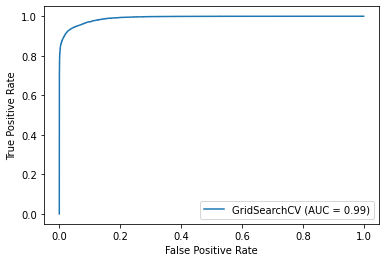

In [83]:
plot_roc_curve(light_grid, X_val, y_val)

In [84]:
!pip install shap

     |████████████████████████████████| 358kB 13.5MB/s 
  Created wheel for shap: filename=shap-0.38.1-cp37-cp37m-linux_x86_64.whl size=490499 sha256=e3ee569bfe423fb132149c44382ce5346d1ab784f0d9a2df2984847693023e9e
  Stored in directory: /root/.cache/pip/wheels/a8/fb/e4/88012be41842b9be62ae18d82d1b1e880daf8539d1fef1fa00
Successfully built shap


In [85]:
row = X_test.iloc[[1]]  # 중첩 brackets을 사용하면 결과물이 DataFrame입니다
row

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,service
1,90035,1,1,36,1,2,2863,1,1,3,1,5,4,5,4,4,4,4,3,4,5,0,0.0,16


In [86]:
y_test.iloc[[1]]

,satisfaction
1,1


In [87]:
grid_tree2.predict(row)

array([1])

In [98]:
import shap

model = grid_xgb.best_estimator_
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(row)

shap.initjs()
shap.force_plot(
    base_value=explainer.expected_value, 
    shap_values=shap_values,
    features=row
)

In [100]:
shap.initjs()
shap_values = explainer.shap_values(X_test.iloc[:100])
shap.force_plot(explainer.expected_value, shap_values, X_test.iloc[:100])

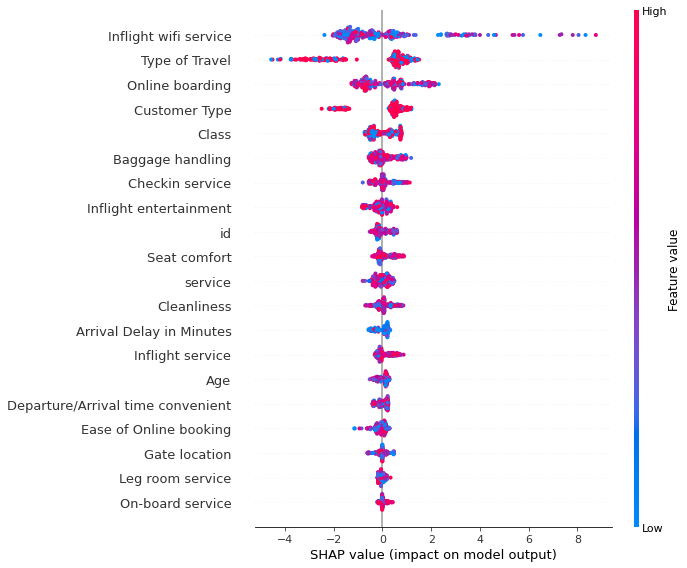

In [101]:
shap_values = explainer.shap_values(X_test.iloc[:300])
shap.summary_plot(shap_values, X_train.iloc[:300])

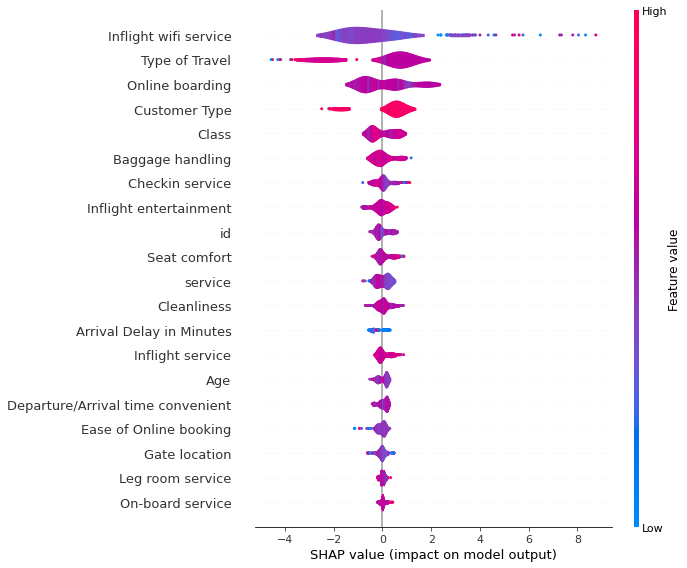

In [102]:
shap.summary_plot(shap_values, X_train.iloc[:300], plot_type="violin")

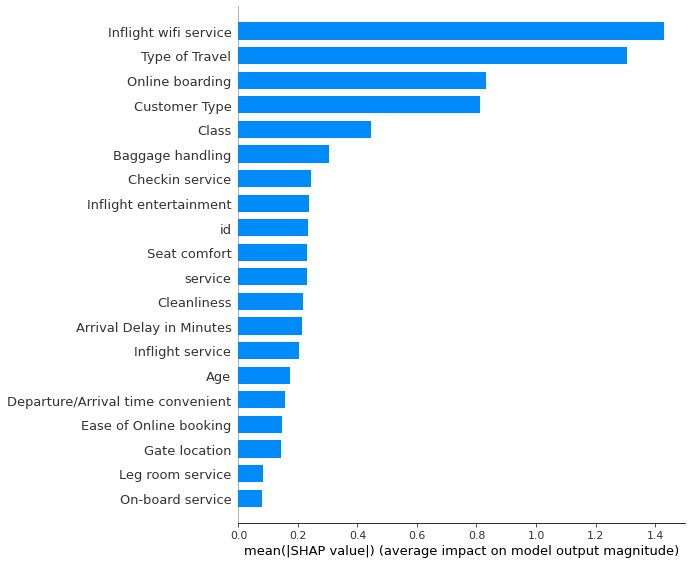

In [103]:
shap.summary_plot(shap_values, X_train.iloc[:300], plot_type="bar")